<h1 style="font-size:500%">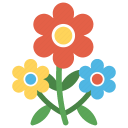 Flower Power</h1>

This notebook is the starting point for wildflower species detection and monitoring in large top view photos of aproximately 1m^2 patches of land using the Eindhoven Wildflower Dataset (EWD) collected and annotated by Gerard Schouten, DOI: [10.34894/U4VQJ6](https://doi.org/10.34894/U4VQJ6) containing images of 6720 x 4480 pixels. This notebook addresses several challenges while using these large images as train-validate-test data for transfer learning a F-RCNN object detection model.

Bas Michielsen MSc

In [1]:
import contextlib, datetime, glob, io, json, math, pandas, os, PIL, random, re, seaborn, shutil, statistics, torch
import matplotlib.pyplot as plt
import torchvision.models.detection as models
import torchvision.transforms as transforms
from torchvision.datasets import VisionDataset
from torchvision.transforms.functional import to_tensor
import torchvision.ops.boxes as bops
from pvoc import load_pvoc_annotations
from cocojamboo import coco_evaluator_class_metrics

print("pandas version:", pandas.__version__)
print("seaborn version:", seaborn.__version__)
print("torch version:", torch.__version__)
print("Is CUDA available?", torch.cuda.is_available())

pandas version: 1.5.0
seaborn version: 0.12.2
torch version: 1.12.1+cu116
Is CUDA available? True


# 🏗️ Set up
Torchvision offers object detection reference scipts that can be used to get started quickly. This notebook uses those scripts and downloads them if they are not present yet. Also, a working folder named `output` is created, and a plotting function is defined.

In [2]:
random_state = 42
data_path = "data"
output_path = "output"


for f in ["coco_eval.py", "coco_utils.py", "engine.py", "transforms.py", "utils.py"]:
    if not os.path.exists(f): wget.download("https://raw.githubusercontent.com/pytorch/vision/main/references/detection/" + f, f)
from engine import train_one_epoch, evaluate

if not os.path.exists(output_path):
    os.mkdir(output_path)
output_path = os.path.join(output_path, datetime.datetime.now().strftime("%Y%m%d%H%M%S"))
if not os.path.exists(output_path):
    os.mkdir(output_path)

def barplot(df, y, x, title, palette=seaborn.color_palette("deep"), orient="h"):
    plt.figure(figsize=(len(plot_data)/7,len(plot_data)/6))
    ax = seaborn.barplot(data=plot_data, y=y, x=x, orient=orient, palette=palette, dodge=False)
    ax.set_title(label=title, loc="left")
    ax.set_xlim(0, 1 + int(plot_data[x].max()) * 1.2)
    ax.set_xlabel(str(int(plot_data[x].sum())) + " " + ax.get_xlabel())
    for i in ax.containers:
        ax.bar_label(i,)

def parse_pycoco_metrics(epoch, pycoco_train_metrics, pycoco_eval_metrics):
    record = dict()
    record["epoch"] = epoch
    for name, value in re.findall('(\w+):[^(]+\(([^)]+)\)', pycoco_train_metrics):
        if name == "lr": continue # exclude learning rate.
        record[name] = float(value)
    for line in pycoco_eval_metrics.split("\n"):
        r = re.search('[^(]+\(([^)]+)\) @\[ IoU=([^|]+)\| area=([^|]+)\| maxDets=([^\]]+)] = (-?\d+.\d+)', line)
        if not r: continue
        m, iou, area, maxDets, value = r.group(1).strip(), r.group(2).strip().replace("0.", "."), r.group(3).strip(), r.group(4).strip(), r.group(5)
        metric = m
        if m == "AP": metric = "Average Precision"
        if m == "AR": metric = "Average Recall"
        iou = " @" + iou + "IoU "
        area = "" if area == "all" else "(" + area + ")"
        maxDets = "" if maxDets == "100" else "[" + maxDets + "]" 
        name = metric + iou + area + maxDets
        record[name] = float(value)
    return record

# Load the dataset
Look at a sample of the data, removing the PVOC features that are not going to be used.

In [3]:
annotations = load_pvoc_annotations(data_path)
df = pandas.DataFrame(annotations)
df.drop(columns=["pose", "truncated", "difficult", "occluded"], axis=1, inplace=True)
df.sample(5)

,filename,width,height,name,xmin,ymin,xmax,ymax
23301,20220511194147-Roadside.jpg,6720,4480,Leucanthemum vulgare,4034,335,4349,579
811,20210605142532-Cropland.jpg,6720,4480,Anthriscus sylvestris,4605,2592,4919,2871
28473,20220616201043-Roadside.jpg,6720,4480,Jasione montana,5847,1293,6058,1496
7808,20210524150415-Grassland.jpg,6720,4480,Buttercup * (aggregate),623,697,746,800
57237,20210528061604-Marsh.jpg,6720,4480,Pedicularis palustris,3250,2124,3512,2468


# ⚛️ Select a pretrained model

Here the F-RCCN model that was pretrained with the [resnet50 feature pyramid network v2](https://arxiv.org/pdf/2111.11429.pdf) backbone is selected as the base model. The ideal image size (`target_size`) can be specified for testing purposes, or is inferred from the model's transform **maximum** input size. The reason for selecting the maximum rather than the mean of the maximum and the minimum is that the minor quality loss as a result of downscaling input images is considered less than the quality loss as a result of cutting through bounding boxes when making tiles in the preprocessing step. So making the least number of tiles is preferred. Given the input image size of 6720 x 4480, using the maximum, and therefore accepting a small loss in resolution results in 15 tiles per input images, whereas using the mean of minimum and maximum (~1024) results in 24 tiles, greatly increasing the number of potentially sliced bounding boxes.

- `target_size` Ideal size for the input images, if 0 then it will be inferred from the selected model.

In [4]:
target_size = 0


model = models.fasterrcnn_resnet50_fpn_v2(weights="DEFAULT")
target_size = model.transform.max_size if target_size == 0 else target_size
print("The target_size for input images is", target_size)

The target_size for input images is 1333


# 🎴 Preprocessing input images
In case the input images are significantly larger than the input size for the model to train, and the bounding boxes for the objects are relatively small, the problem could arise that when the large input image is automatically resized, the objects inside the bounding boxes degrade greatly in resolution. Therefore, it is better to have input images that are closer to the correct input size for the model (target_size), and having bounding boxes that are relatively large in respect to the input images. A helper function is used to slice the input images into slices that are close to the target size.

  - `wubble_margin` The number of pixels as a fraction of the slice width/height that a slicing line may move to become less destructive. *Coined by Gerard Schouten after been explained about the behaviour of how the line moves to the least destructive position "Oh, so it wubbles?", as in 'clumsily move from one side to the other'*.
  - `input_path` The path that the preprocessed images should be saved to.
  - `data_file` The file containing all annotations after preprocessing.
  - `force_preprocessing` If the file at `data_file` already exists, preprocessing will be skipped. Set this to True, to preprocess regardless.

In [5]:
wubble_margin = .2
input_path = "input"
data_file = "data.csv"
force_preprocessing = False

def partition(annotations: list, size: int, margin: float, input_path: str, output_path: str):
    result = []
    line_margin = int(size * margin)
    filenames = []
    for obj in annotations:
        filename = obj["filename"]
        if not filename in filenames:
            filenames.append(filename)
    for filename in filenames:
        objects = [x for x in annotations if x["filename"] == filename]
        width, height = objects[0]["width"], objects[0]["height"]
        image = PIL.Image.open(os.path.join(input_path, filename))
        filename, fileext = os.path.splitext(filename)
        vertical_num = int(width / size)
        vertical_size = int(width / vertical_num)
        num_vertical_lines = vertical_num -1
        vertical_lines = []
        for i in range(1, num_vertical_lines +1):
            line = i * vertical_size
            line = _get_slice_line(line, line_margin, objects, "xmin", "xmax")
            vertical_lines.append(line)
        vertical_lines.append(width)
        horizontal_num = int(height / size)
        horizontal_size = int(height / horizontal_num)
        num_horizontal_lines = horizontal_num -1
        horizontal_lines = []
        for i in range(1, num_horizontal_lines +1):
            line = i * horizontal_size
            line = _get_slice_line(line, line_margin, objects, "ymin", "ymax")
            horizontal_lines.append(line)
        horizontal_lines.append(height)  
        prev_v = 0
        prev_h = 0
        row = 0
        for h in horizontal_lines:
            number = 0
            row = row + 1
            for v in vertical_lines:
                number = number +1
                new_filename = filename + "_" + _get_row_letter(row) + str(number) + fileext
                for obj in [x for x in objects if (x["xmin"] < v and x["xmin"] > prev_v and x["ymin"] < h and x["ymin"] > prev_h) or (x["xmax"] < v and x["xmax"] > prev_v and x["ymax"] < h and x["ymax"] > prev_h)]:
                    if obj["xmin"] < prev_v and obj["xmax"] > prev_v:
                        if obj["xmax"] - prev_v > int((obj["xmax"] - obj["xmin"])/2):
                            obj["xmin"] = prev_v
                        else:
                            continue
                    if obj["xmin"] < v and obj["xmax"] > v:
                        if v - obj["xmin"] > int((obj["xmax"] - obj["xmin"])/2):
                            obj["xmax"] = v
                        else:
                            continue
                    if obj["ymin"] < prev_h and obj["ymax"] > prev_h:
                        if obj["ymax"] - prev_h > int((obj["ymax"] - obj["ymin"])/2):
                            obj["ymin"] = prev_h
                        else:
                            continue
                    if obj["ymin"] < h and obj["ymax"] > h:
                        if h - obj["ymin"] > int((obj["ymax"] - obj["ymin"])/2):
                            obj["ymax"] = h
                        else:
                            continue
                    obj["filename"] = new_filename
                    obj["width"] = v - prev_v
                    obj["height"] = h - prev_h
                    obj_w = obj["xmax"] - obj["xmin"]
                    obj_h = obj["ymax"] - obj["ymin"]
                    obj["xmin"] = obj["xmin"] - prev_v
                    obj["ymin"] = obj["ymin"] - prev_h
                    obj["xmax"] = obj["xmin"] + obj_w
                    obj["ymax"] = obj["ymin"] + obj_h
                    result.append(obj)
                tile = image.crop((prev_v, prev_h, v, h))
                tile.save(os.path.join(output_path, new_filename))
                prev_v = v
            prev_h = h
            prev_v = 0
    return result

def _get_slice_line(mid, margin, objects, min_index, max_index):
    if margin == 0:
        return mid
    results = dict()
    for d in range(margin):
        for delta in {d, d*-1}:
            line = mid + delta
            count = sum([1 for obj in objects if (obj[min_index] < line and obj[max_index] >= line)])
            if count == 0: # Return if a 'perfect' line is found.
                return line
            results[line] = count
    return min(zip(results.values(), results.keys()))[1] # Return the line with the least sliced objects.

def _get_row_letter(row): 
    return str(chr(ord('`')+row))

if force_preprocessing or not os.path.exists(input_path) or not os.path.exists(os.path.join(input_path, data_file)):
    annotations = load_pvoc_annotations(data_path) 
    if os.path.exists(input_path):
        shutil.rmtree(input_path)
    os.mkdir(input_path)
    data = partition(annotations, target_size, wubble_margin, data_path, input_path)
    pandas.DataFrame(data).to_csv(os.path.join(input_path, "data.csv"), index=False)
df = pandas.read_csv(os.path.join(input_path, data_file))

# 🎆 Demonstrating a preprocessing result
The following code demonstrates the result of the preprocessing step, given the filename of an original image. If no filename is given, it takes a random original image. This cell can be re-run to get a another random image.

  - `demo_image` The filename of the original image for which the preprocessing result should be demonstrated. Can be left empty to take a random original image.

Image: data/20210403170602-Grassland.jpg


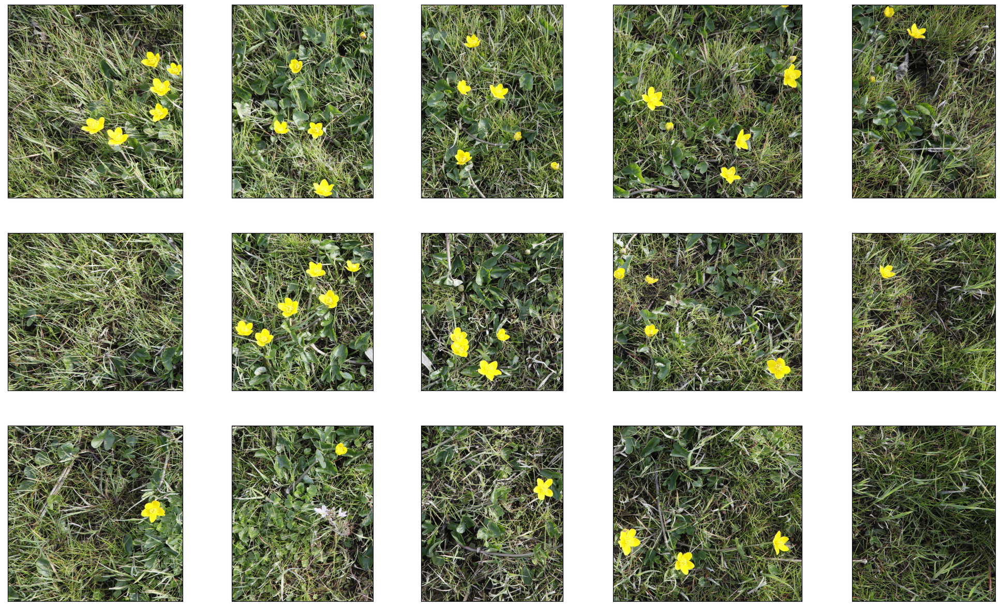

In [8]:
demo_image = ""


if demo_image == "":
    filenames = list(set(x["filename"] for x in df.to_dict("records")))
    demo_image = random.sample(filenames, k=1)[0]
    _, ext = os.path.splitext(demo_image)
    demo_image = os.path.join(data_path, demo_image[:demo_image.rfind("_")]+ext)

def collect(path: str, image_path: str):
    columns = 0
    image_name, ext = os.path.splitext(os.path.basename(image_path))
    files = glob.glob(os.path.join(path, image_name + "*"))
    for f in files:
        if f[f.rfind("_")+1:][0] == "a": columns += 1
        else: continue
    rows = int(len(files) / columns)
    ratios_w, ratios_h, images = [], [], []
    for row in range(rows):
        row += 1
        for col in range(columns):
            col += 1
            img = PIL.Image.open(os.path.join(path, image_name + "_" + _get_row_letter(row) + str(col) + ext))
            if len(ratios_w) < columns: ratios_w.append(img.width)
            if col == 0 or col % columns == 0: ratios_h.append(img.height)
            images.append(img)
    return images, rows, columns, ratios_w, ratios_h

print("Image:", demo_image)
images, rows, columns, ratios_w, ratios_h = collect(input_path, demo_image)
fig, subplots = plt.subplots(nrows=rows, ncols=columns, figsize=(25,15), gridspec_kw={"width_ratios":ratios_w, "height_ratios":ratios_h})
subplots = subplots.flatten()
for i in range(len(images)):
    subplots[i].set_xticks([])
    subplots[i].set_yticks([])
    subplots[i].imshow(images[i])

# 🔭 Observations overview
An overview of the number of observations per label is presented below.

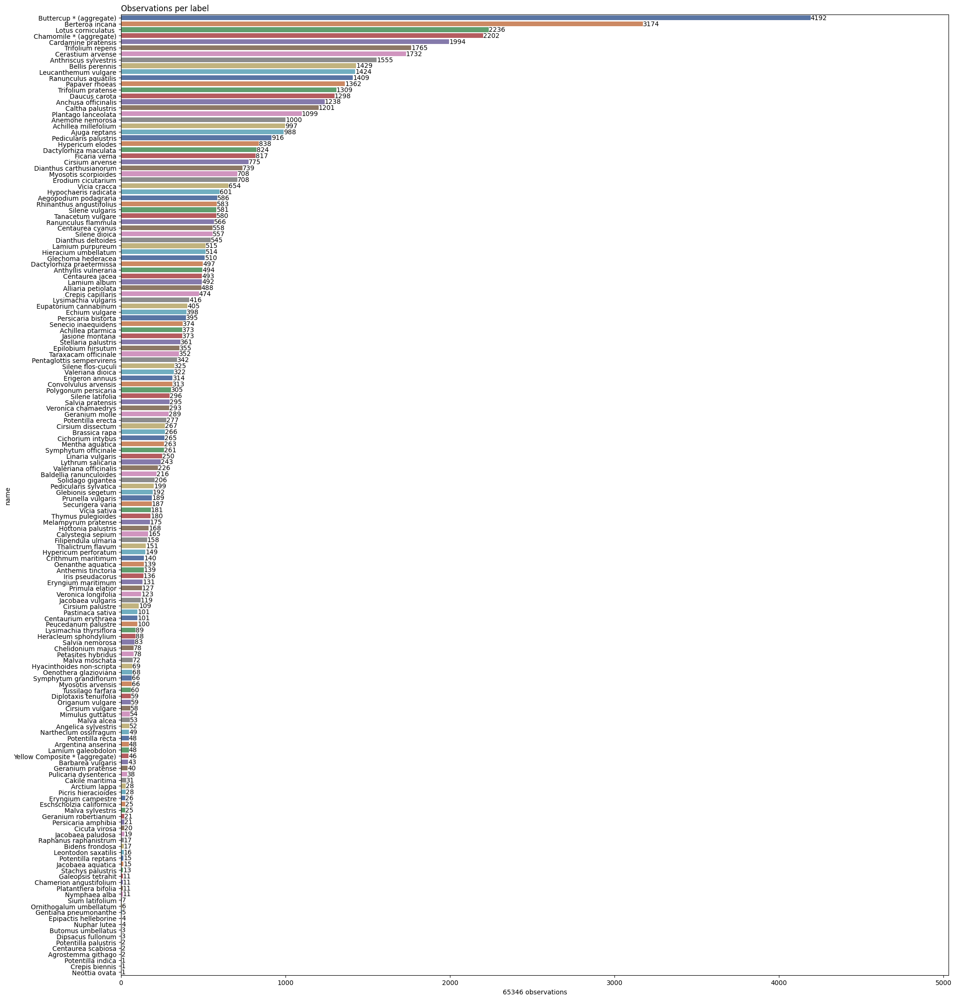

In [9]:
plot_data = df.groupby(by=["name"])["width"].count().rename("observations").reset_index().sort_values(by="observations", ascending=False)
barplot(plot_data, "name", "observations", "Observations per label")

# 🪓 Train-Validate-Test split
Due to the fact that in object detection a single image could contain observations for multiple objects as well as for different objects it is not easy to make a balanced data set. If a certain image is selected for the reason that it has an observation for one specific object it may collaterally include more objects. By providing the sample size for the three different datasets (train, validate, test) it is possible to calculate all permutations of possible solutions that bring to the exact numbers and then select one of those permutations randomly. However, this approach of precalculating all permutations beforehand takes exponentially more time when the dataset gets larger. Therefore, the function below takes a trial-and-error approach by making many attempts and stopping early when a solutions is found, which only takes linearly more time when the dataset gets larger. If no solution is found with a certain set of attempts, it starts removing rarer objects from the dataset and try again, until a perfect solution is found. It is thus technically possible that an earlier perfect solution does exist but is not found, a label gets removed, and then the function returns the next best perfect solution. However the likelihood for this to happen for a specific label is inverse to the number of observations for that label relative to the required sample size (`train_size` + `validate_size` + `test_size`). The function starts by immediately removing labels having a number of observations less than 110% of the required sample size and increases this margin with steps of 10% for every n attempts at finding a perfect solution. The value for n can be increased in order to be more parsimonious about removing labels, at the cost of increasing calculation time.
 - `train_size` The number of observations per label in the train dataset.
 - `validate_size` The number of observations per label in the validate dataset.
 - `test_size` The number of observations per label in the test dataset.
 - `n_attempts` The number of attempts to make per increment in margin.

The train set has 12250 observations.
The validate set has 2450 observations.
The test set has 2450 observations.
The following labels were removed:
 ['Crepis biennis', 'Neottia ovata', 'Potentilla indica', 'Agrostemma githago', 'Centaurea scabiosa', 'Dipsacus fullonum', 'Potentilla palustris', 'Butomus umbellatus', 'Gentiana pneumonanthe', 'Epipactis helleborine', 'Nuphar lutea', 'Ornithogalum umbellatum', 'Galeopsis tetrahit', 'Sium latifolium', 'Bidens frondosa', 'Chamerion angustifolium', 'Raphanus raphanistrum', 'Cakile maritima', 'Nymphaea alba', 'Platanthera bifolia', 'Stachys palustris', 'Arctium lappa', 'Origanum vulgare', 'Barbarea vulgaris', 'Diplotaxis tenuifolia', 'Leontodon saxatilis', 'Malva sylvestris', 'Persicaria amphibia', 'Tussilago farfara', 'Centaurium erythraea', 'Geranium robertianum', 'Jacobaea aquatica', 'Potentilla reptans', 'Thymus pulegioides', 'Cicuta virosa', 'Symphytum grandiflorum', 'Malva alcea', 'Picris hieracioides', 'Potentilla recta', 'Myosotis arv

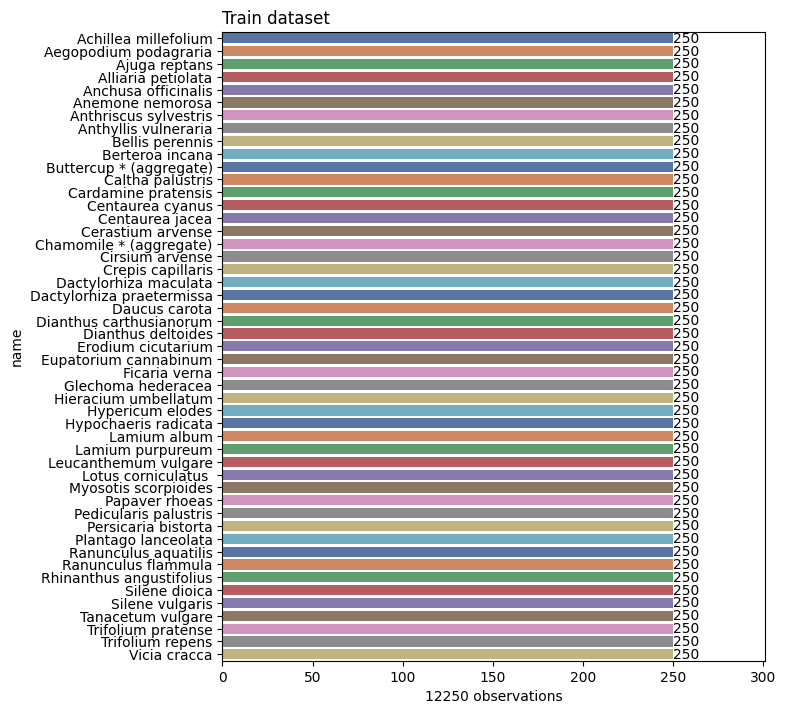

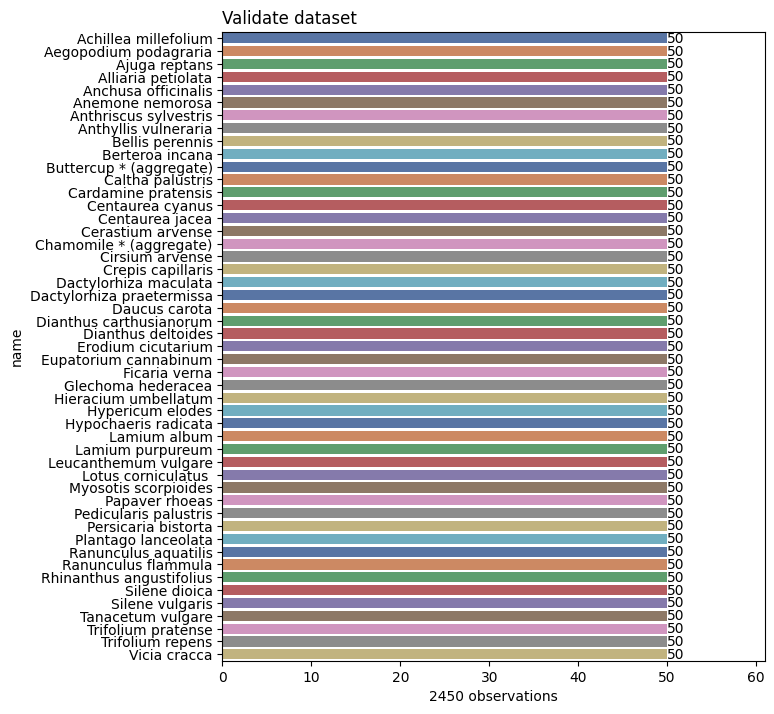

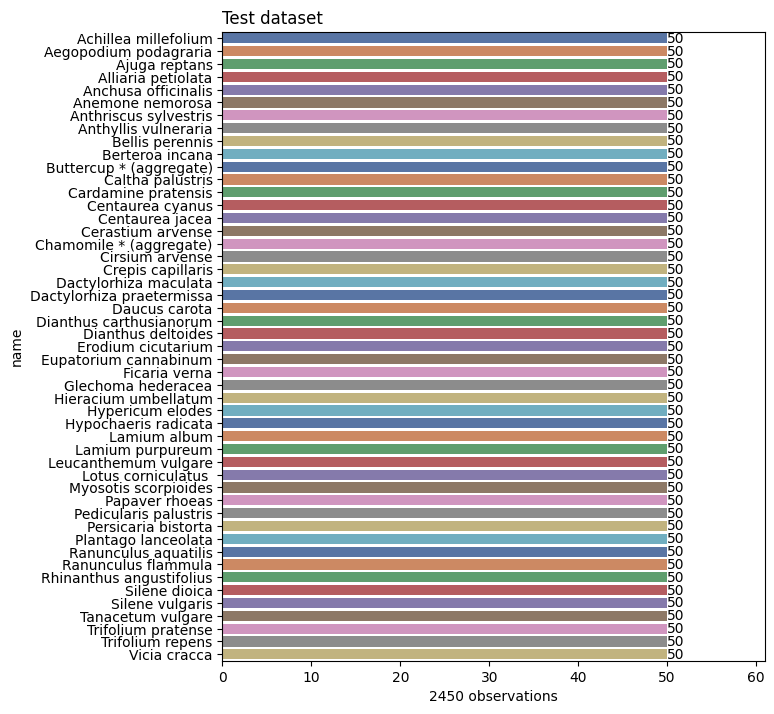

In [10]:
train_size = 250
validate_size = 50
test_size = 50
n_attempts = 9


def random_items_with_sum(items, target_sum):
    if target_sum <= 0: return None
    for _ in range(len(items.keys())*1000): # If a combination is not found after this many attempts, we assume it does not exist. It is a magic number, but we need some sort of escape.
        k = random.randint(0, len(items.keys()))
        combination = random.sample(list(items.keys()), k=k)
        if sum([items[k] for k in combination]) == target_sum:
            return dict(((key, items[key]) for key in combination))
    return None

def balanced_train_validate_test_split(data, train_size, validate_size, test_size, n_attempts, random_state=None):
    import random, copy
    if random_state != None: random.seed(random_state)
    names = list(set([x["name"] for x in data]))
    train, validate, test, removed = [], [], [], []
    groups = df.groupby(by=["name", "filename"])["width"].count().to_dict()
    rows = dict()
    for k, v in groups.items(): # Make a pool of files per class name and the number of times the class appears in that file.
        name = k[0]
        if name in rows: rows[name][k[1]] = v
        else: rows[name] = {k[1]:v}
    margin = 0.0
    found = False
    while not found:
        margin += .05
        for _ in range(n_attempts):
            records = copy.deepcopy(rows)
            train, validate, test, removed = [], [], [], []
            labels = sorted(records, key=lambda k: len(records[k]))
            for label in labels:
                items = records[label]
                if sum(items.values()) < (train_size + validate_size + test_size) * (1.0 + margin):
                    for lbl in labels:
                        records[lbl] = dict(((key, records[lbl][key]) for key in records[lbl] if key not in items.keys()))
                    removed.append(label)
            labels = [x for x in labels if x not in removed]
            labels.reverse()
            for label in labels:
                items = records[label]
                test_items = None
                test_size_for_label = test_size - len([x for x in test if x["name"] == label])
                if test_size_for_label > 0:
                    test_items = random_items_with_sum(items, test_size_for_label)
                    if test_items == None: break
                validate_items = None
                validate_size_for_label = validate_size - len([x for x in validate if x["name"] == label])
                if validate_size_for_label > 0:
                    validate_items = random_items_with_sum(items, validate_size_for_label)
                    if validate_items == None: break        
                train_items = None
                train_size_for_label = train_size - len([x for x in train if x["name"] == label])
                if train_size_for_label > 0:
                    train_items = random_items_with_sum(items, train_size_for_label)
                    if train_items == None: break
                for lbl in labels:
                    records[lbl] = dict(((key, records[lbl][key]) for key in records[lbl] if key not in items.keys()))
                if test_items != None:
                    test += [x for x in data if x["filename"] in test_items]
                if validate_items != None:
                    validate += [x for x in data if x["filename"] in validate_items]
                if train_items != None:
                    train += [x for x in data if x["filename"] in train_items]
            selected = len(names) - len(removed)
            found = (len(test) == selected * test_size) and (len(validate) == selected * validate_size) and (len(train) == selected * train_size)
            if found: 
                break
    return train, validate, test, removed

data = df.to_dict("records")
train_data, validate_data, test_data, removed = balanced_train_validate_test_split(data, train_size, validate_size, test_size, n_attempts, random_state=random_state)
print("The train set has", len(train_data), "observations.")
pandas.DataFrame(train_data).to_csv(os.path.join(output_path, "train.csv"), index=False)
print("The validate set has", len(validate_data), "observations.")
pandas.DataFrame(validate_data).to_csv(os.path.join(output_path, "validate.csv"), index=False)
print("The test set has", len(test_data), "observations.")
pandas.DataFrame(test_data).to_csv(os.path.join(output_path, "test.csv"), index=False)
print("The following labels were removed:\n", removed)

plot_data = pandas.DataFrame(train_data).groupby(by=["name"])["width"].count().rename("observations").reset_index().sort_values(by=["observations", "name"])
barplot(plot_data, "name", "observations", "Train dataset")

plot_data = pandas.DataFrame(validate_data).groupby(by=["name"])["width"].count().rename("observations").reset_index().sort_values(by=["observations", "name"])
barplot(plot_data, "name", "observations", "Validate dataset")

plot_data = pandas.DataFrame(test_data).groupby(by=["name"])["width"].count().rename("observations").reset_index().sort_values(by=["observations", "name"])
barplot(plot_data, "name", "observations", "Test dataset")

# 🌷 Species
An overview of the species that the model will be trained on.

The species that the model will be trained on are:


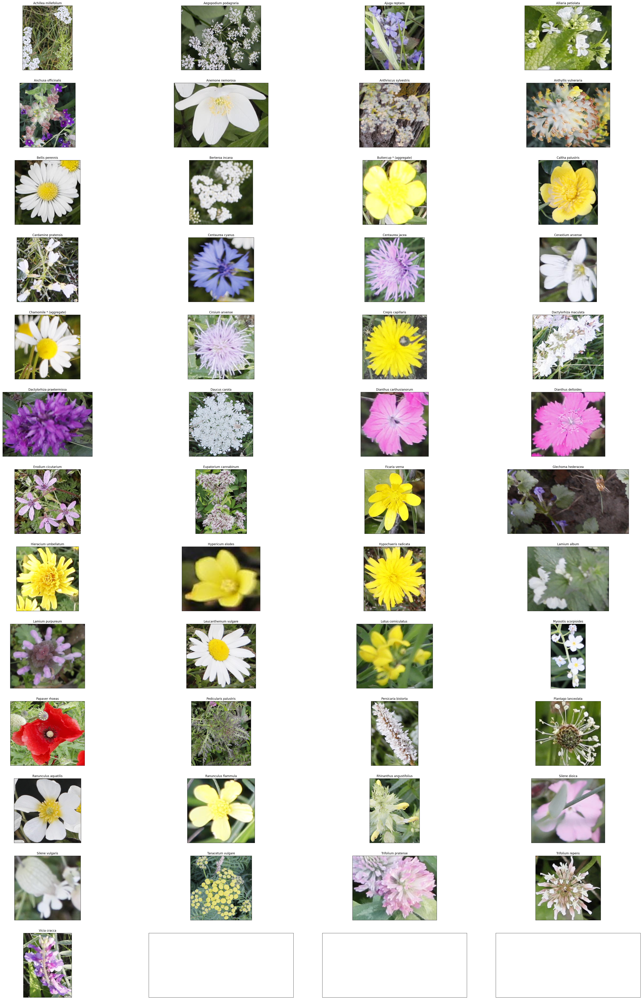

In [11]:
species = [name for name in list(set(x["name"] for x in test_data))]
random.shuffle(species)
classes = ["__background__"] + species
model.roi_heads.box_predictor = models.faster_rcnn.FastRCNNPredictor(model.roi_heads.box_predictor.cls_score.in_features, len(classes))    
print("The species that the model will be trained on are:")
df_species = pandas.DataFrame(train_data)
df_species["size"] = df_species.apply(lambda x: (x["xmax"] - x["xmin"]) * (x["ymax"] - x["ymin"]), axis=1)
df_species = df_species.sort_values("size", ascending=False).drop_duplicates(["name"]).sort_values("name")
plot_data = df_species.to_dict("records")
rows = math.ceil(len(plot_data)/4)
cols = 4
fig, subplots = plt.subplots(nrows=rows, ncols=cols, figsize=(len(plot_data), len(plot_data)*1.5))
subplots = subplots.flatten()
for i, file in enumerate(plot_data):
    img = PIL.Image.open(os.path.join(input_path, file["filename"]))
    img = img.crop((file["xmin"], file["ymin"], file["xmax"], file["ymax"]))
    subplots[i].imshow(img)
    subplots[i].set(title=file["name"])
for i in range(rows * cols):
    subplots[i].set_xticks([])
    subplots[i].set_yticks([])

# 🗃️ Compose the data sets
In order for Torchvision to read the data, three different DataSets needs to be composed. One of them is for the training data, a second for the validation data, and the last for the test data.

In [12]:
class Dataset(VisionDataset):
    def __init__(self, root, data, classes, transforms=None, transform=None, target_transform=None):
        super().__init__(root, transforms, transform, target_transform)
        self.classes = classes
        self.images = glob.glob(os.path.join(self.root, "*.jpg"))
        self.data = data
        images = []
        for obj in data:
            filename = obj["filename"]
            if not filename in images:
                images.append(filename)
        self.images = images

    def __getitem__(self, i):
        image_path = os.path.join(self.root, self.images[i])
        image = PIL.Image.open(image_path).convert("RGB")
        objects, labels = [], []
        records = [x for x in self.data if x["filename"] == self.images[i]]
        for record in records:
            objects.append([int(record["xmin"]), int(record["ymin"]), int(record["xmax"]), int(record["ymax"])])
            labels.append(self.classes.index(record["name"]))
        boxes = torch.as_tensor(objects, dtype=torch.float32)
        target = {}
        target["boxes"] = boxes
        target["labels"] = torch.as_tensor(labels)
        target["image_id"] = torch.tensor([i])
        target["area"] = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:,0]) if len(boxes) > 0 else torch.zeros(1)
        target["iscrowd"] = torch.zeros((len(boxes),), dtype=torch.int64)
        if self.transforms is not None:
            image = self.transforms(image)
        tensor = to_tensor(image)
        return tensor, target
    
    def __len__(self):
        return len(self.images)

train_transforms = transforms.Compose([
        transforms.RandomAdjustSharpness(sharpness_factor=4),
        transforms.RandomAutocontrast()
])

train_dataset = Dataset(input_path, train_data, classes, transforms=train_transforms)
print("The train dataset contains", len(train_dataset), "images.")
validate_dataset = Dataset(input_path, validate_data, classes)
print("The validate dataset contains", len(validate_dataset), "images.")
test_dataset = Dataset(input_path, test_data, classes)
print("The test dataset contains", len(test_dataset), "images.")

The train dataset contains 3012 images.
The validate dataset contains 642 images.
The test dataset contains 630 images.


# ♻️ Prepare data loaders and a maximum number of epochs
A data loader arranges for the data in the dataset to be loaded into the memory of the system in batches. It is possible to increase the batch size if enough free memory is available.

- `batch_size` The number of images per step to load into memory.

In [13]:
batch_size = 6


def collate(batch):
    return tuple(zip(*batch))
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0, collate_fn=collate)
validate_loader = torch.utils.data.DataLoader(validate_dataset, batch_size=1, shuffle=False, num_workers=0, collate_fn=collate)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=0, collate_fn=collate)

# ▶️ Run training and gather validation metrics
The object detection reference scripts from PyTorch vision will be used to run a train + validate loop. The functions `train_one_epoch` and `evaluate` are called repeatedly until the point of early stopping is reached, calculated by finding no more gain in validation performance. In this case an SGD optimizer with momentum is used, and the learning rate scheduler is instructed to step after every epoch. The outcomes of the `train_one_epoch` and the `evaluate` functions are collected and parsed such that a report can be generated.

In [14]:
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
model.to(device)
freq = math.ceil(len(train_dataset) / batch_size / 4)
report, early_stop_metrics = [], []
epoch = 0
while True:
    epoch += 1
    train_result = train_one_epoch(model, optimizer, train_loader, device, epoch, freq)
    train_metrics = train_result.__str__()
    eval_result = evaluate(model, validate_loader, device=device)
    buffer = io.StringIO()
    with contextlib.redirect_stdout(buffer): # Little trick to capture eval_result.summarize() into a buffer.
        eval_result.summarize()
    eval_metrics = buffer.getvalue()
    record = parse_pycoco_metrics(epoch, train_metrics, eval_metrics)
    report.append(record)
    scheduler.step()
    early_stop_metric = record["Average Precision @.50IoU "]
    early_stop_metrics.append(early_stop_metric)
    if len(early_stop_metrics) >= 5 and early_stop_metric <= statistics.mean(early_stop_metrics[-5:]):
        print("Early stopped at epoch", epoch, "result:", early_stop_metric, "<= mean(", early_stop_metrics[-5:], ")")
        break

Epoch: [1]  [  0/502]  eta: 0:20:24  lr: 0.005000  loss: 4.6317 (4.6317)  loss_classifier: 4.1095 (4.1095)  loss_box_reg: 0.2753 (0.2753)  loss_objectness: 0.2338 (0.2338)  loss_rpn_box_reg: 0.0130 (0.0130)  time: 2.4391  data: 0.3108  max mem: 10665
Epoch: [1]  [126/502]  eta: 0:05:34  lr: 0.005000  loss: 1.0794 (1.1265)  loss_classifier: 0.6237 (0.6931)  loss_box_reg: 0.4276 (0.3909)  loss_objectness: 0.0116 (0.0342)  loss_rpn_box_reg: 0.0052 (0.0083)  time: 0.8688  data: 0.2756  max mem: 18264
Epoch: [1]  [252/502]  eta: 0:03:42  lr: 0.005000  loss: 0.7889 (1.0559)  loss_classifier: 0.5103 (0.6433)  loss_box_reg: 0.2896 (0.3808)  loss_objectness: 0.0099 (0.0242)  loss_rpn_box_reg: 0.0052 (0.0076)  time: 0.8888  data: 0.2831  max mem: 18264
Epoch: [1]  [378/502]  eta: 0:01:50  lr: 0.005000  loss: 0.7503 (0.9685)  loss_classifier: 0.4973 (0.6005)  loss_box_reg: 0.2415 (0.3405)  loss_objectness: 0.0086 (0.0205)  loss_rpn_box_reg: 0.0052 (0.0071)  time: 0.8766  data: 0.2709  max mem: 18

# ⚖️ Show train and validation metrics report
The collected training and validation metrics report is shown below. The first four metrics about loss refer to the loss during training. The 12 metrics after that are COCO generated validation metrics over all the epochs.

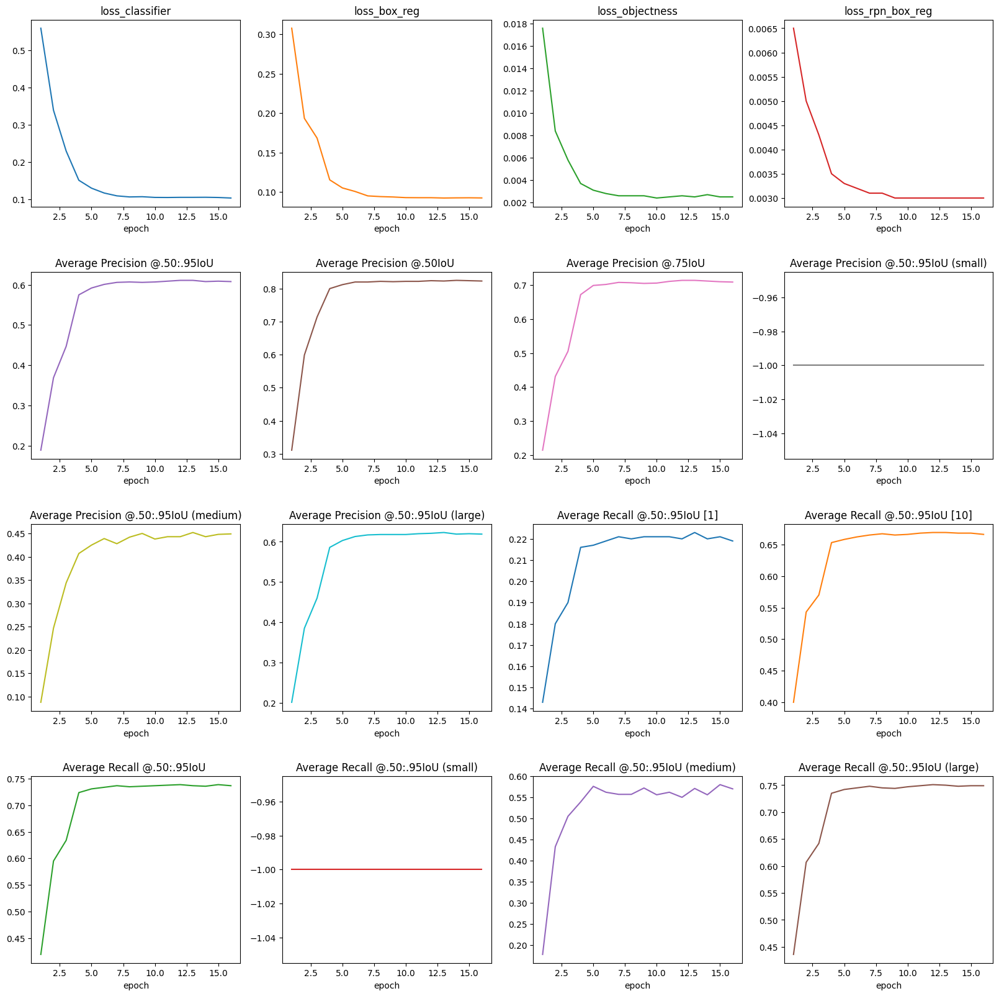

In [15]:
metrics = pandas.DataFrame(report)
metrics.plot(subplots=True, layout=(5,4), figsize=(20,25), x="epoch", sharex=False, title=metrics.columns.to_list()[1:], legend=False)
plt.subplots_adjust(hspace=0.35)

# ✅ Run against the test data
Now the model is ran against the earlier separated test dataset to get the COCO metrics per class. And again to create a confusion matrix.

In [16]:
results, metrics = coco_evaluator_class_metrics(model, test_loader, device)
df_testresults = pandas.DataFrame(results, columns=metrics)
df_testresults["Class"] = df_testresults["Class"].map(dict(enumerate(classes)))
df_testresults.drop(["AP[IoU=0.50:0.95]", "AP[IoU=0.75]", "AR[IoU=0.50:0.95]"], axis=1, inplace=True)
df_testresults = df_testresults.sort_values(by="AP[IoU=0.50]", ascending=False)
df_testresults

creating index...
index created!
Test:  [  0/630]  eta: 0:00:38  model_time: 0.0437 (0.0437)  evaluator_time: 0.0016 (0.0016)  time: 0.0617  data: 0.0130  max mem: 19627
Test:  [100/630]  eta: 0:00:32  model_time: 0.0390 (0.0401)  evaluator_time: 0.0013 (0.0016)  time: 0.0594  data: 0.0143  max mem: 19627
Test:  [200/630]  eta: 0:00:25  model_time: 0.0397 (0.0398)  evaluator_time: 0.0012 (0.0015)  time: 0.0605  data: 0.0153  max mem: 19627
Test:  [300/630]  eta: 0:00:19  model_time: 0.0401 (0.0400)  evaluator_time: 0.0012 (0.0015)  time: 0.0608  data: 0.0148  max mem: 19627
Test:  [400/630]  eta: 0:00:14  model_time: 0.0405 (0.0401)  evaluator_time: 0.0014 (0.0018)  time: 0.0624  data: 0.0154  max mem: 19627
Test:  [500/630]  eta: 0:00:07  model_time: 0.0389 (0.0402)  evaluator_time: 0.0016 (0.0018)  time: 0.0600  data: 0.0145  max mem: 19627
Test:  [600/630]  eta: 0:00:01  model_time: 0.0404 (0.0403)  evaluator_time: 0.0013 (0.0018)  time: 0.0619  data: 0.0150  max mem: 19627
Test:  [

,Class,AP[IoU=0.50]
33,Centaurea cyanus,0.993064
1,Ajuga reptans,0.981664
2,Persicaria bistorta,0.973919
18,Lamium album,0.970103
23,Lamium purpureum,0.969962
13,Alliaria petiolata,0.968566
8,Dactylorhiza praetermissa,0.966242
20,Cirsium arvense,0.961846
43,Hypericum elodes,0.947519
15,Anemone nemorosa,0.946386


<AxesSubplot: xlabel='Class', ylabel='AP[IoU=0.50]'>

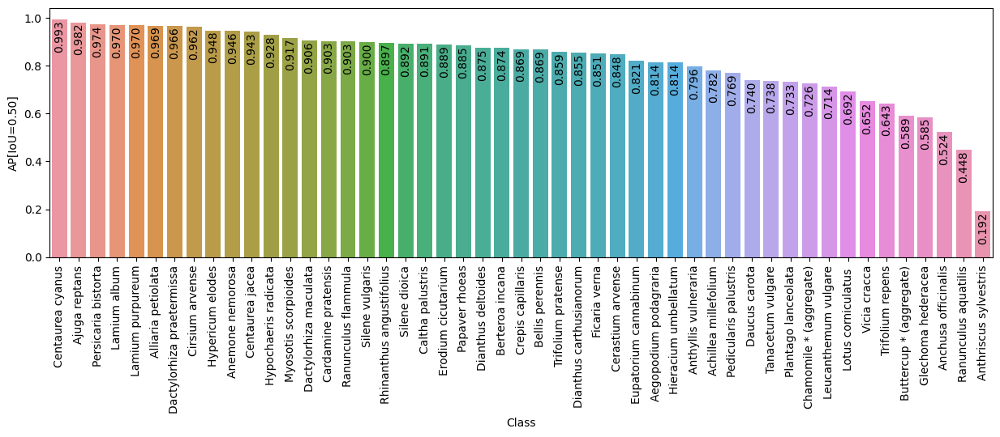

In [17]:
plt.figure(figsize=(15, 4)) 
plot = seaborn.barplot(x=df_testresults["Class"], y=df_testresults["AP[IoU=0.50]"])
plot.bar_label(plot.containers[0], rotation="vertical", fmt="%.3f", padding=-29)
plot.tick_params(axis="x", labelrotation=90)
plot

<AxesSubplot: >

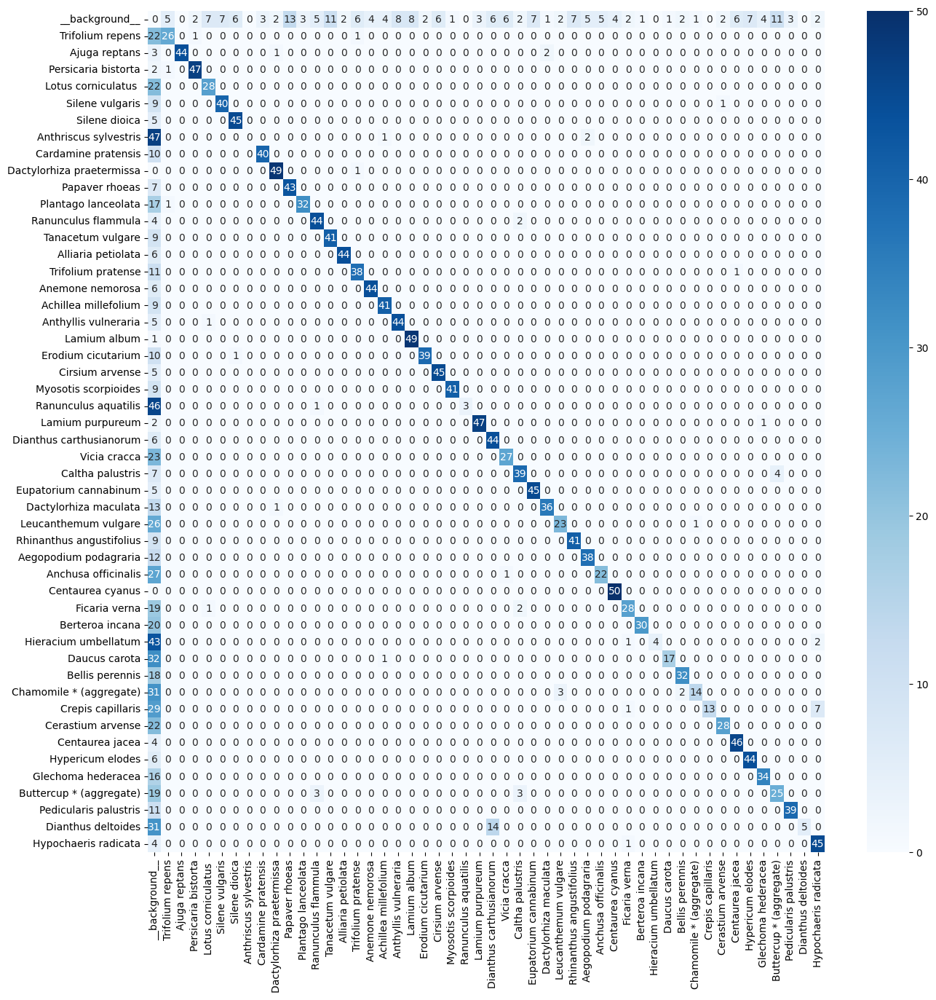

In [18]:
def generate_confusion_matrix(model, device, dataset, classes, score_threshold=.7, iou_threshold=.5):
    import torchvision.ops.boxes as bops
    num_threads = torch.get_num_threads()
    torch.set_num_threads(1)
    cpu_device = torch.device("cpu")
    model = model.to(device)
    model.eval()
    matrix_size = len(classes)
    matrix = [[0 for x in range(matrix_size)] for y in range(matrix_size)]
    
    for i in range(len(dataset)):
        img, targets = dataset[i]
        imgs = list([img.to(device)])
        if torch.cuda.is_available():
            torch.cuda.synchronize()
        output = model(imgs)
        output[0]["boxes"] = output[0]["boxes"][output[0]["scores"] >= score_threshold]
        output[0]["labels"] = output[0]["labels"][output[0]["scores"] >= score_threshold]
        output[0]["scores"] = output[0]["scores"][output[0]["scores"] >= score_threshold]
        output = [{k: v.to(cpu_device) for k, v in t.items()} for t in output]

        output = output[0]
        pred_boxes = output["boxes"].detach()
        pred_labels = output["labels"].detach().tolist()
        truth_boxes = targets["boxes"].detach()
        truth_labels = targets["labels"].detach().tolist()

        ious = bops.box_iou(truth_boxes, pred_boxes).detach()
        for tid, v in enumerate(ious):
            if len(v) == 0 or torch.max(v) < iou_threshold: # missed truth box
                q = truth_labels[tid]
                matrix[truth_labels[tid]][0] += 1
            else: # overlaps
                pid = torch.topk(v, 1)[1].item()
                tindex = truth_labels[tid]
                pindex = pred_labels[pid]
                matrix[tindex][pindex] += 1
        ious = bops.box_iou(pred_boxes, truth_boxes).detach()
        for pid, v in enumerate(ious):
            pindex = pred_labels[pid]
            if torch.sum(v).item() == 0: # prediction with no matching truth box.
                matrix[0][pindex] += 1

    torch.set_num_threads(num_threads)
    return matrix

matrix = generate_confusion_matrix(model, device, test_dataset, classes)
plt.figure(figsize=(15,15))
seaborn.heatmap(matrix, annot=True, xticklabels=classes, yticklabels=classes, cmap="Blues")

<AxesSubplot: >

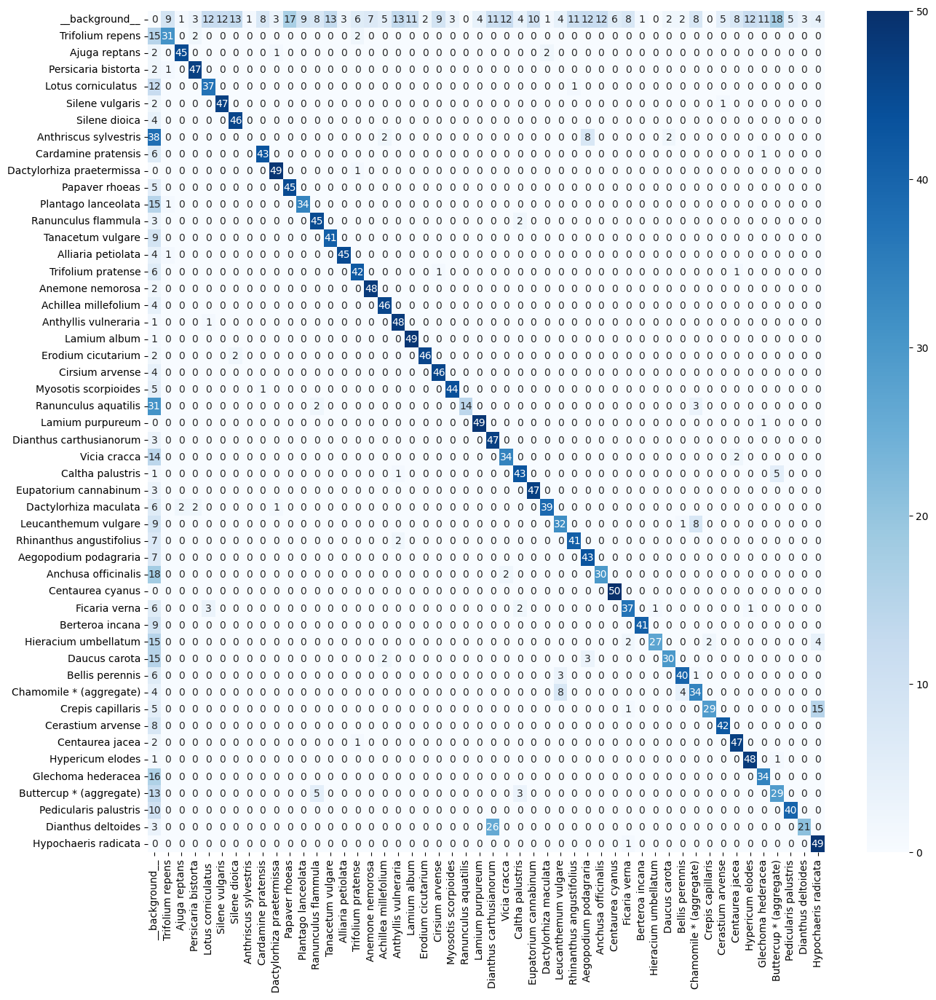

In [19]:
matrix = generate_confusion_matrix(model, device, test_dataset, classes,score_threshold=.5)
plt.figure(figsize=(15,15))
seaborn.heatmap(matrix, annot=True, xticklabels=classes, yticklabels=classes, cmap="Blues")

# 💾 Save the model
The model is saved to disk using the pytorch default `model.state_dict()` that produces a file can be loaded again later.

In [20]:
torch.save(model.state_dict(), os.path.join(output_path, "model"))
f = open(os.path.join(output_path, "classes.json"), 'w')
json.dump(classes, f)
f.close()